# Logistic  regression
### <span style='color:yellow'> Logistic regression is a machine learning method that uses the favor of linear regression for a  classification task.</span>

### <span style='color:yellow'>In the previous tutorial we described the linear regression, and please go and check that tutorial since we use most conventional forms therein.</span>

# Approximation
### <span style='color:yellow'>The data is modeled by using a linear function to have continuous values.</span>
$$
   \LARGE{f(w,b) = wx + b}
$$

# Sigmoid activation function (prediction)
### <span style='color:yellow'> In logistic regression we do not need continuous values. </span>

### <span style='color:yellow'> The sigmoid function is used to covert the continuous values (taken from the linear modeling) into probabilities (for classification).</span>


$$
    \LARGE{\hat{y} = {h_{\theta}x} =\frac{1}{1+e^{-wx+b}}}
$$


### <span style='color:yellow'> The input of the sigmoid function can be either positive or negative. Intuitively, the positive inputs are considered data from a class, and the negative inputs are considered data from another class.</span>

### <span style='color:yellow'>  If the input is positive, then the output of the sigmoid function will equal > 0.5, and if it is negative it will return a prediction value <0.5 as an output.</span>
   
### <span style='color:yellow'> In practice, we map all predictions that are > 0.5 into class 1, and all predictions <0.5 into class 0, i.e, to match with the categorical labels.</span>
    
### <span style='color:yellow'> Both positive and negative classes are seen as binary classification problems <0.5 as an output.</span>
    
<img  src='vanilla logistic regression.png' width=350>

### <span style='color:yellow'> In practice: the logistic function can be  modified to squeeze the values from (-i,i) (to 0,1) <0.5 </span>
$$
    \LARGE{\hat{y} = h_\theta x =  \frac{e^{wx+b}}{e^{wx+b}+1}}
$$
    
<img src="logistic modified.png" width=200 >

# Cost function (optimization)
### <span style='color:yellow'> Logistic regression uses binary cross entropy function (not MSE). </span>

### <span style='color:yellow'> The likelihood is the joint probability of a given data for a set of parameters. </span>
$$ 
L(\theta|data)=P(data|\theta)
$$

$$ 
\large {Cross \, entropy \, \, or Log(Liklihood)}=J(w,b)= \frac{1}{N}\Sigma_{i=1}^n[y^i log(h_\theta (x^i))+(1-y^i)log(1-h_\theta(x^i))]
$$
### <span style='color:yellow'> The root (gradient, or derivative) of the cross entropy function comes from liner transformation (modeling). </span> 

### <span style='color:yellow'> The task at hand is binary classification, i.e, Bernoulli distribution is utilized </span> 
$$ 
y \sim Bern \, \sigma(h_\theta(x^i)
$$

$$ 
y \in \{0,1\}
$$

### <span style='color:yellow'>Where:</span> 
$$
\hat{y}=\sigma(h(x)) = \sigma(\theta^{T}(x))
$$

### <span style='color:yellow'>The likelihood for a set of independent data points:</span> 
$$
L (\theta|X)= P (X|\theta) =\prod_{i=1}^n P(y_i|x_i,\theta)
$$

### <span style='color:yellow'>Because of Bernoulli distribution, the likelihood become:</span>
$$
L (\theta|X)= P (X|\theta) =\prod_{i=1}^n \sigma(h(x_i))^y{_i} + \sigma(1-h(x_i))^{(1-y_i)}
$$

### <span style='color:yellow'>Considering the Log of the likelihood  leads to the cross-entropy cost function:</span>

$$ 
\large {Log(L(\theta|X))}=J(w,b)= \frac{1}{N}\Sigma_{i=1}^n[y^i log(h_\theta (x^i))+(1-y^i)log(1-h_\theta(x^i))]
$$

### <span style='color:yellow'>Conclusion: the root (derivative) gives the gradient of the loss function, and because it is rooted in the linear regression, thus the same gradient for weights and bias will be utilized.</span>

### <span style='color:yellow'>The goal is to reduce the difference between actual and predicted labels, which is done by using the gradient " derivative"  of the cost function with respect to w, b</span> 
<img src=gradient.png width=320>

### <span style='color:yellow'> The gradient descent is an iterative method to get to the minimum through a descent way. When calculating the gradient, we use the gradient descent technique to update the learning parameters.</span> 

### <span style='color:yellow'>The gradient descent starts with the initialization of the weights and biases and goes to the negative direction of the gradient, where the algorithm run iteratively until reaching to the minimum </span> 
<img src='gradient_descent.png' width=350>

### <span style='color:yellow'>Update rule: at each iteration, we apply the update rule:</span> 
$$\large{w=w-\alpha.dw}$$

$$\large{b=b-\alpha.db}$$

### <span style='color:yellow'>We use - beacuse we go the negative directioin.</span>




### <span style='color:yellow'>Learning rate</span> 
<img src='lr.png' width=600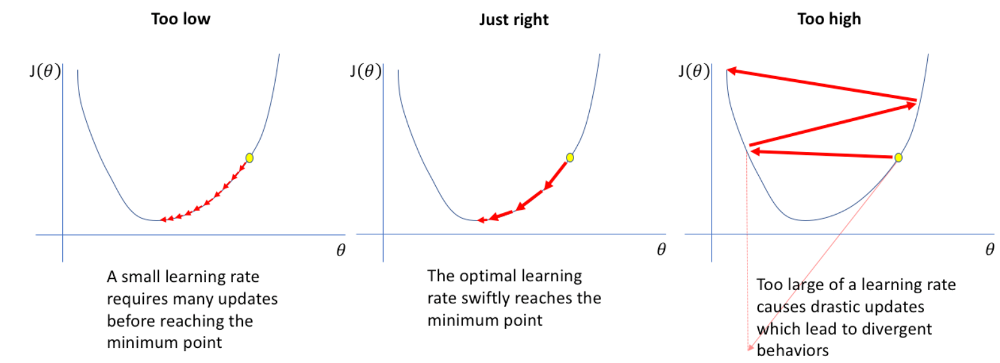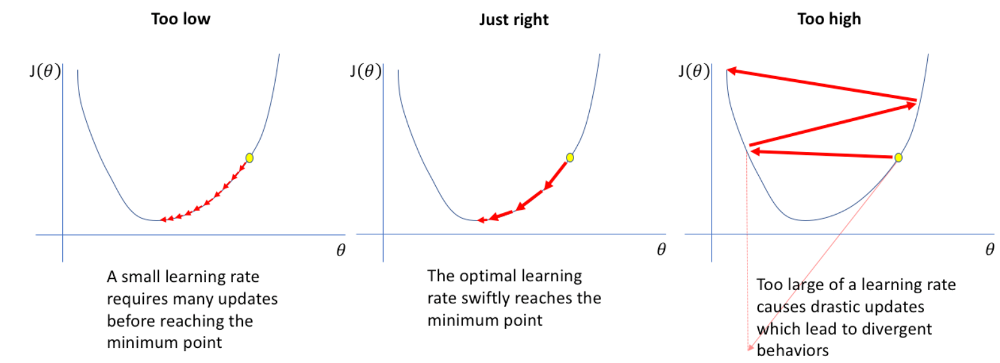>

In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity='all'

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn import datasets

In [14]:
binary_cross_data=datasets.load_breast_cancer()
X,y=binary_cross_data.data,binary_cross_data.target
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=1234)
X.shape


(569, 30)

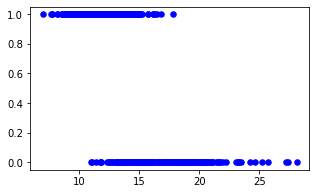

(455, 30)
(455,)


In [15]:
'Visualizing the created dataset'
fig=plt.figure(figsize=(5,3))
plt.scatter(X[:,0],y,color='b',marker="o",s=30)
plt.show()
print(X_train.shape)
print(y_train.shape)

In [4]:
import numpy as np

class LogisticRegressor:
    def __init__(self,lr=0.001,n_iteration=1000):
        self.lr=lr
        self.n_iteration=n_iteration
        self.weights=None
        self.bias=None
        self.gradient_weight=[]
        self.opt_weight=[]
        self.opt_prediction=[]
    
    def fit(self,X,y):
        n_samples,n_features= X.shape
        self.weights=np.zeros(n_features)
        self.bias=0
  

            
        for _ in range(self.n_iteration):
            lin_reg_model=np.dot(X,self.weights)+self.bias
            y_predicted=self._sigmoid(lin_reg_model)
            dw=(1/n_samples)*np.dot(X.T,(y_predicted-y))
            db=1/(n_samples)*np.sum(y_predicted-y)
            self.weights-=self.lr*dw
            self.bias-=self.lr*db
        plt.show()
            
            
    def predict(self,X):
        lin_reg_model = np.dot(X, self.weights) + self.bias
        y_predicted = self._sigmoid(lin_reg_model)
        predicted_class=[1 if i >0.5 else 0 for i in y_predicted ]
        return predicted_class

    def _sigmoid(self,x):
        return (1/(1+ np.exp(-x)))



In [16]:
from Logistic_Regressor import LogisticRegressor

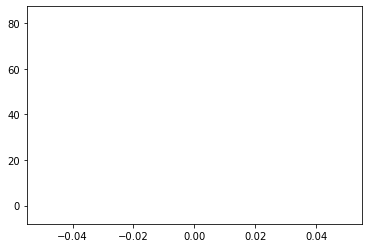

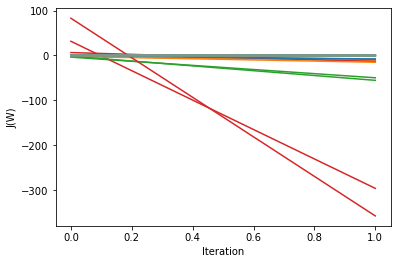

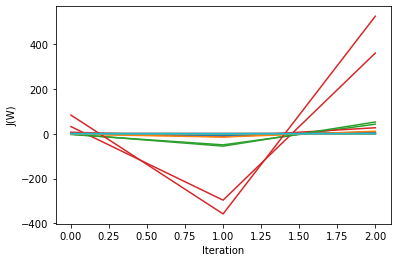

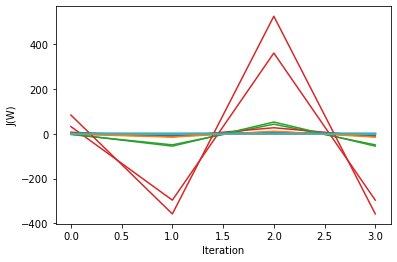

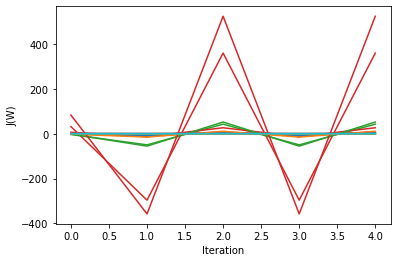

...

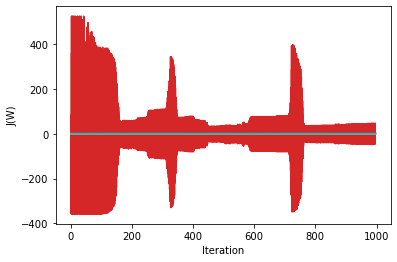

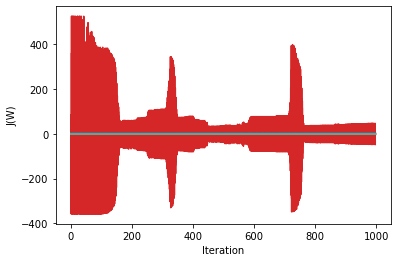

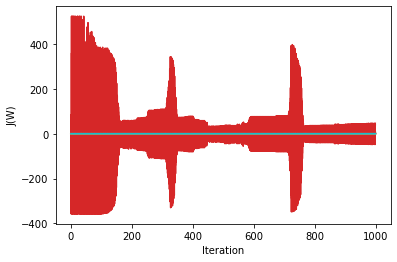

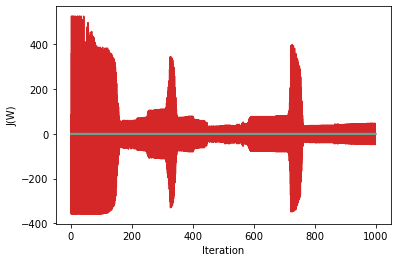

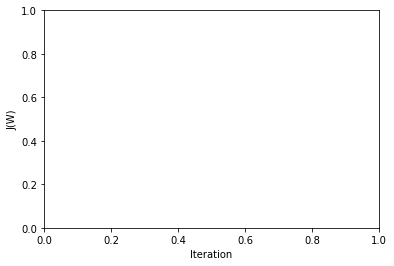

In [17]:
Logistic_regressor=LogisticRegressor(lr=0.01,n_iteration=1000)
Logistic_regressor.fit(X_train,y_train)
prediction=Logistic_regressor.predict(X_test)


In [ ]:
def accuracy_mertic( y_true,y_predicted):
    accuracy=np.sum(y_true==y_predicted)/len(y_true)
    return accuracy

In [ ]:
accuracy=accuracy_mertic(y_test,prediction)
accuracy

0.9210526315789473